# Praktyczne wykorzystanie NumPy i wizualizacji do symulowania ruchów Browna za pomocą procesu Wienera

W ramach tego scenariusza spróbujemy połączyć to czego nauczyliśmy się o NumPy i wizualizacji do matematycznego modelowania i symulowania procesu fizycznego, którego wyjaśnieniem zajmował się sam wielki Albert Einstein!

**Uwaga:** Na początku będzie troszeczkę teorii, ale nie powinniśmy się zrażać, bo pozwoli nam ona na generowanie ciekawych rysunków :).

Do opracowania niniejszego scenariusza wykorzystane zostały następujące materiały źródłowe:
- https://isquared.digital/blog/2020-04-12-random-walk/
- https://isquared.digital/blog/2020-04-16-brownian-motion/
- https://ipython-books.github.io/133-simulating-a-brownian-motion/
- https://github.com/tirthajyoti/Stats-Maths-with-Python/blob/master/Brownian-motion-with-Python.ipynb
- https://medium.com/@mlblogging.k/simulating-brownian-motion-and-stock-prices-using-python-17b6b4bd2a1
---

**Ruchy Browna**

[Ruchy Browna](https://pl.wikipedia.org/wiki/Ruchy_Browna) – chaotyczne ruchy cząstek w płynie (cieczy lub gazie), wywołane zderzeniami zawiesiny z cząsteczkami płynu.

- W 1827 roku szkocki botanik Robert Brown obserwując przez mikroskop pyłki kwiatowe w zawiesinie wodnej dostrzegł, iż znajdują się one w nieustannym, chaotycznym ruchu.

- Matematyczny opis ruchów Browna podali niezależnie Albert Einstein (1905) i Marian Smoluchowski (1906).

- Matematycznym modelem fizycznego zjawiska ruchów Browna jest proces Wienera, który może być zastosowany do modelowania również w innych dziedzinach wiedzy, np. ekonomii.

- Proces Wienera to proces stochastyczny z czasem ciągłym

<center>
<img src=img/Brownian_motion_large.gif width="200" height="240">
<div>Rys 1. Symulacja ruchu Browna dużej cząsteczki w otoczeniu wielu mniejszych cząstek poruszających się w różnych kierunkach i z różną prędkością (źródło: <a href=https://pl.wikipedia.org/wiki/Ruchy_Browna>Wikipedia</a>).</div>
</center>

Do konstrukcji procesu Wienera użyjemy innego, prostego procesu stochastycznego, tzw. **błądzenia losowego**. Ale po kolei. Zaczniemy od pojęcia rozkładu normalnego prawdopodobieństwa. 

**Rozkład normalny**

Rozkład normalny $N(\mu,\sigma)$, zwany też rozkładem Gaussa, to rodzina rozkładów prawdopodobieństwa zadanych funkcją gęstości

$$f_{\mu ,\sigma }(x)={\frac {1}{\sigma {\sqrt {2\pi }}}}\,\exp \left({\frac {-(x-\mu )^{2}}{2\sigma ^{2}}}\right),$$

gdzie $\mu$ i $\sigma$ to parametry określające odpowiednio średnią i odchylenie standardowe danego rozkładu.

Standardowy rozkład normalny $N(0,1)$ to rozkład normalny z wartością oczekiwaną $\mu = 0$ i odchyleniem standardowym $\sigma = 1$.

Wyrysujemy wykresy funkcji gęstości dla kilku rozkładów normalnych - są to słynne *krzywe dzwonowe*. Sami zaimplementujemy funkcję gęstości (pamiętajmy o zapewnieniu wektoryzacji!) lub skorzystamy z implementacji w bibliotece [scipy](https://scipy.org/):

In [1]:
import numpy as np
import pandas as pd
# Biblioteka do tworzenia interaktywnych wykresów (https://plotly.com/python/)
import plotly.express as px
# Funkcja wyliczająca wartość gęstości rozkładu normalnego o zadanych parametrach
from scipy.stats import norm


# "Ręczna" imlementacja funkcji gęstości zapewniająca wektoryzację
def norm_pdf(x, mean=0, sd=1):
    
    r = 1./(sd * np.sqrt(2*np.pi)) * np.exp( (-(x-mean)**2) / (2 * (sd**2)) )
    
    return r


mus = [0,0,0,5]
sds = [1,2,5,3]

x = np.linspace(-15, 15, 1000)
norm_pdfs = pd.DataFrame({'x': x})

for i, name in enumerate(['N(0,1)','N(0,2)','N(0,5)','N(5,3)']):
    
    # Możemy użyć własnej implementacji funkcji gęstości
    norm_pdfs[name] = norm_pdf(x, mean=mus[i], sd=sds[i])
    
    # lub skorzystać z implementacji w odpowiedniej bibliotece, w tym przypadku scipy
    #norm_pdfs[name] = norm.pdf(x, loc=mus[i], scale=sds[i])

norm_pdfs = norm_pdfs.melt(id_vars='x', var_name='Rozkład normalny')
fig = px.line(norm_pdfs, x='x', y='value', color='Rozkład normalny')
fig.update_layout(yaxis_title=r'Wartość funkcji gęstości')
fig.show()

**Centralne Twierdzenie Graniczne (CTG)**

Istnieje kilka sformułowań tego niezwykle ważnego twierdzenia. Poniżej przedstawimy jedno z nich. 

Jeżeli $X_i$ są niezależnymi zmiennymi losowymi pochodzącymi z tej samej populacji o wartości oczekiwanej $\mu$ oraz dodatniej i skończonej wariancji $\sigma^{2}$, to ciąg zmiennych losowych $U_{n}$ w postaci znormalizowanych wartości oczekiwanych 

$$U_n = \frac{\frac{1}{n}\sum_{i=1}^n X_i - \mu}{\sigma / \sqrt{n}}$$

zbieżny jest <u>według rozkładu</u> do standardowego rozkładu normalnego, gdy $n\to +\infty$. Inaczej rzecz ujmując:

$$\lim _{n\to \infty}P(U_{n}<u)={\frac {1}{\sqrt {2\pi }}}\int _{-\infty }^{u}e^{-x^{2}/2}\,dx.$$

**Błądzenie losowe**

Niech $\{\epsilon_k\}_{k\in \mathbb{N}}$ będzie ciągiem niezależnych i jednakowo rozłożonych dyskretnych zmiennych losowych takich, że $\mathbb{P}(\{\epsilon_k=\pm1\}) = \frac{1}{2}$. **Błądzenie losowe** zadane przez ciąg zmiennych losowych $\{X_n\}_{n\in \mathbb{N}}$ definiujemy w następujący sposób:

$$X_n = \sum_{k=0}^{n}\epsilon_k.$$

Na mocy CTG ciąg zmiennych losowych $X_n$ definiujących błądzenie losowe jest zbieżny według rozkładu do standardowego rozkładu normalnego $N(0,1)$, gdy $n\to +\infty$:

$$\frac{X_n}{\sqrt{n}} \underset{D}\longrightarrow N(0,1).$$

No dobrze. Twierdzenie twierdzeniem, ale mimo wszystko spróbujmy naocznie przekonać się, czy matematycy mają rację ;). Zobaczmy, czy CTG działa dla błądzenia losowego.

Zaczniemy od napisania funkcji, która generuje realizację procesu błądzenia losowego zgodnie z definicją przedstawioną powyżej:

In [3]:
def random_walk(N, initial_value=0):
    """
    Symulacja błądzenia losowego
    
    :param int N : liczba kroków
    :param int initial_value: punkt startowy
    """
    # możliwe przyrosty
    increments = np.array([1, -1])
    # prawdopodobieństwo wylosowania 1
    p=0.5

    # losowanie wartości dla kolejnych przyrostów 
    random_increments = np.random.choice(increments, N, p)
    # obliczenie bładzenia losowego
    random_walk = np.cumsum(np.concatenate((np.array([initial_value]), random_increments)))


    return random_walk, random_increments

Zobaczmy jak działa nasza funkcja - wygenerujemy przykładową realizację (zwaną też trajektorią) procesu, którą wyrysujemy tym razem za pomocą Matplotlib:

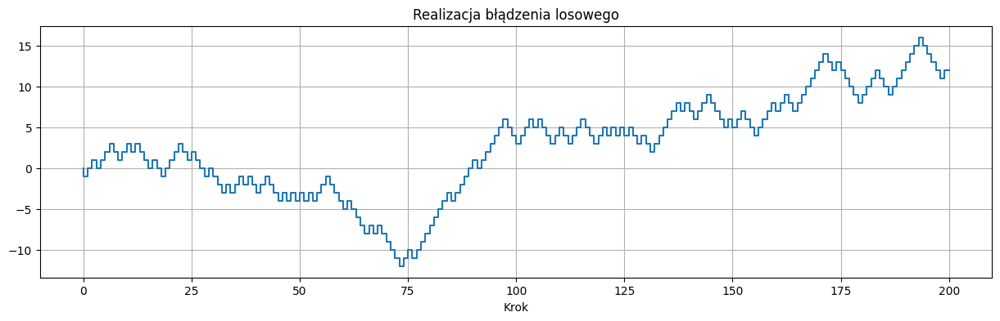

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

N = 200 # Liczba kroków

X, epsilon = random_walk(N)

plt.figure(figsize=(15,4))
# Pomiędzy kolejnymi krokami wartość jest stała, więc do rysowania użyjemy funkcji plt.step()
plt.step(range(N+1), X)
# Dodajemy siatkę, w celu zwiększenia czytelności wykresu
plt.grid()
plt.title('Realizacja błądzenia losowego')
plt.xlabel('Krok')
plt.show()

Teraz przejdziemy do sprawdzenia działania Centralnego Twierdzenia Granicznego. W tym celu wygenerujemy wiele (np. 10000) realizacji błądzenia losowego o tej samej długości N. Dla każej realizacji rozważać będziemy jej końcową wartość (tj. wartość zmiennej $X_N$), którą znormalizujemy dzieląc przez $\sqrt{N}$, aby spełnić warunki CTG. Wyrysujemy histogram dla tych wszystkich znormalizowanych wartości i porównamy z wykresem $N(0,1)$. W celu zaobserwowania zbieżności, powtórzymy to dla różnych warości N, tj. 5, 10, 100, i 10000.

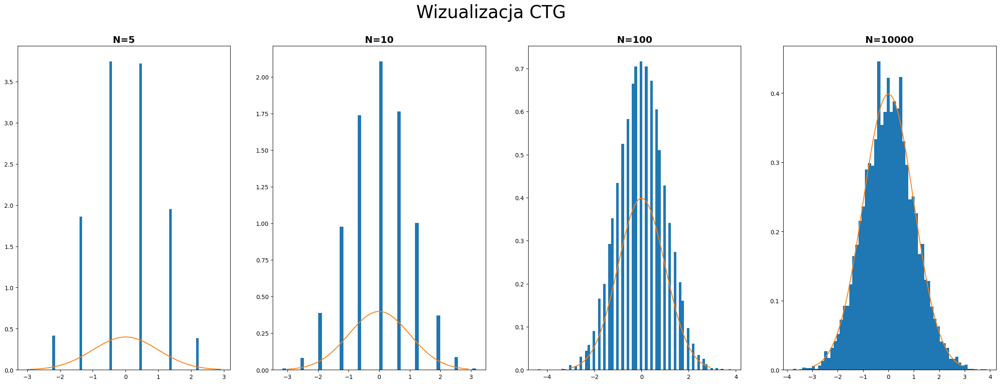

In [5]:
from scipy.stats import norm

# Liczba realizacji
R = 10000

# Długości realizacji
Ns = [5, 10, 100, 10000]

x_axis = np.arange(-3, 3, 0.1) 

# Tworzymy wykres składający się z kilku podwykresów. Podwykresy są na razie puste i będą
# uzupełniane poniżej w pętli iterującej po długościach realizacji.
fig, axs = plt.subplots(1,len(Ns),figsize=(30,10))
fig.suptitle('Wizualizacja CTG', fontsize=30)

# Iteracja po długościach realizacji
for i, N in enumerate(Ns):

    # Tablica, która będzie przechowywać ostatnie wartości poszczególnych realizacji
    XNs = np.zeros(R)

    # Iteracja po realizacjach błądzenia losowego
    for r in range(R):
        
        # Generowanie realizacji
        X, _ = random_walk(N)
            
        # Zapamiętujemy tylko ostatnią wartość realizacji po uprzednim jej znormalizowaniu zgodnie z założeniami CTG
        XNs[r] = X[-1] * (1./np.sqrt(N))

    # Rysujemy histogram
    # Uwaga: Ustawienie density na True powoduje przeskalowanie histrogramu tak, że suma wysokości "słupków" przemnożonych przez ich szerokość wynosi 1.
    #        Pozwala to nam na wizualne porównywanie histogramów (tj. empirycznych rozkładów) z funkcją gestości rozkładu teoretycznego.
    axs[i].hist(XNs, density=True, bins='auto')
    # Nakładamy wykres N(0,1)
    axs[i].plot(x_axis, norm.pdf(x_axis, 0, 1))
    axs[i].set_title(f'{N=}', fontweight="bold", size=16)

Nasze wyniki możemy podsumować tak: matematycy mają rację!

Zauważmy, że CTG ma zastosowanie dla dowolnego rozkładu. Przy okazji jeszcze sprawdźmy jak CTG działa dla zmiennych losowych pochodzących z rozkładu wykładniczego, którego funkcja gęstości ma następującą postać:

$$f_{\lambda}(x) = \lambda e^{-\lambda x} \cdot \mathbb{1}_{[0,\infty)}.$$

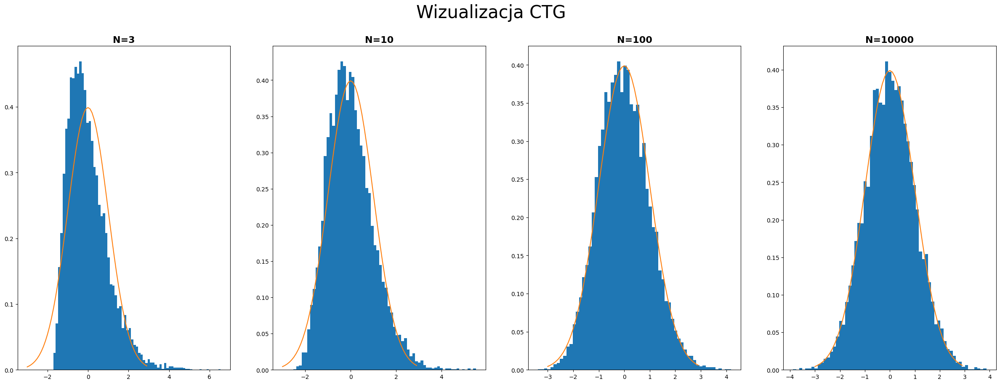

In [6]:
# Aby móc generować wartości z rozkładu wykładniczego
from scipy.stats import expon

# Ustawienie wartości parametru lambda rozkładu wykładniczego
lambda_exp = 1.0

# Liczba powtórzeń
R = 10000

# Wielkości prób
Ns = [3, 10, 100, 10000]

x_axis = np.arange(-3, 3, 0.1) 

# Tworzymy wykres składający się z kilku podwykresów. Podwykresy są na razie puste i będą
# uzupełniane poniżej w pętli iterującej po wilekości prób.
fig, axs = plt.subplots(1,len(Ns),figsize=(30,10))
fig.suptitle('Wizualizacja CTG', fontsize=30)

# Iteracja po wielkości prób.
for i, N in enumerate(Ns):

    # Tablica, która będzie przechowywać statystykę U dla poszczególnych powtórzeń
    Us = np.zeros(R)

    # Iteracja po powtórzeniach
    for r in range(R):
        
        # Generowanie próby, tj. wartości dla N niezależnych zmiennych losowych z rozkładu wykładniczego z parametrem lambda_exp. 
        X = expon.rvs(scale = 1./lambda_exp, size=N)
        # Na podstawie wygenerowanej próby obliczamy nową zmienną losową (statystykę) U występującą w CTG
        Us[r] = (np.sum(X)/N - 1./lambda_exp) * np.sqrt(N) * lambda_exp

    axs[i].hist(Us, density=True, bins='auto')
    axs[i].plot(x_axis, norm.pdf(x_axis, 0, 1))
    axs[i].set_title(f'{N=}', fontweight="bold", size=16)

---

Przejdziemy teraz do procesu stochastycznego z czasem ciągłym o ciągłych wartościach. 

**Intuicja:** Rozważmy błądzenie losowe składające się z $N$ dyskretnych kroków, które są rozmieszczone równomiernie na przedziale $[0,1]$. Na przykład, dla $N=10$ mamy nastepujące punkty krokowe: $\{0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0\}$. Dodatkowo wartości błądzenia losowego w tych punktach będziemy dzielić przez $\sqrt{N}$. Wyobraźmy sobie teraz, że zwiększamy $N$. Wówczas punkty krokowe zagęszczają się, tj. stają się coraz bliższe sobie i w granicy utworzą continuum. 

Wróćmy do naszej powyższej definicji prostego błądzenia losowego:

$$X_n = \sum_{k=0}^{n}\epsilon_k,$$

gdzie $\mathbb{P}(\{\epsilon_k=\pm1\}) = \frac{1}{2}$ dla każdego $n \in \mathbb{N}$.

Używając tak zdefiniowanego procesu, skonstruujemy nowy proces następująco:

$$W_t^N = \frac{X_{\lfloor Nt \rfloor}}{\sqrt{N}}, \quad t \in [0,1], \quad N \in \mathbb{N}.$$

Jak powyżej, z Centralnego Twierdzenia Granicznego wynika, że dla $t=1$ mamy 

$$W_1^N = \frac{X_{N}}{\sqrt{N}} \underset{D}\longrightarrow N(0,1)$$.

Zwróćmy uwagę, że Centralne Twierdzenie Graniczne ma zastosowanie tylko dla $t=1$; nie zachodzi dla pozostałych wartości $t$ (gdyż dzielimy przez $\sqrt{N}$ a nie $\sqrt{\lfloor Nt \rfloor}$). Okazuje się jednak, że na mocy innego twierdzenia ([twierdzenie Donsker'a](https://en.wikipedia.org/wiki/Donsker%27s_theorem)) dla $N \rightarrow +\infty$ mamy

$$W_t^N \underset{D}\longrightarrow W_t,$$

tj. nasz proces zbiega do [procesu Wienera](https://pl.wikipedia.org/wiki/Proces_Wienera) $W = (W_t)_{t \geq 0}$.

Tutaj skonstruowaliśmy proces Wienera używając prostego błądzenia losowego o jednostkowych przyrostach występujących z jednakowym prawdopodobieństwem. 
Okazuje się, że w ogólności przyrosty te mogą być generowane z dowolnego rozkładu, najczęściej spotyka się w tym kontekście rozkład normalny. Dzieje się tak dzięki ogólności (niezależności od konkretnego rozkładu) zarówno Centralnego Twierdzenia Granicznego jak i twierdzenia Donsker'a.

---
**Dla zainteresowanych:**

Procesem Wienera nazywamy proces stochastyczny $W = (W_t)_{t \geq 0}$ taki, że:
- $W_0 = 0$ prawie na pewno;
- $W$ ma przyrosty niezależne: $W_{t+u} - W_t$ jest niezależna od $W_s$ dla każdego $t > 0$, $u \geq 0$, $s \leq t$;
- $W$ ma przyrosty gaussowskie: $W_{t+u} - W_t \sim N(0,u)$;
- realizacje $W$ są ciągłe z prawdopodobieństwem 1: istnieje $A \in \mathcal{F}$ ($\mathcal{F}$ to $\sigma$-ciało przestrzeni probabilistycznej $(\Omega, \mathcal{F}, \mathsf{P})$, na której określony jest proces) taki, że $\mathsf{P}(A) = 1$ i dla każdej $\omega \in A$ funkcja $t \mapsto W_{t}(\omega)$ jest ciągła na $[0,\infty)$.

**Uwaga**: Niektórzy autorzy definiują proces Wienera zakładając, że realizacja są po prostu ciągłe i że $W_0 \equiv 0$.

Więcej o procesach stochastycznych można dowiedzieć się na przedmiocie [Wstęp do analizy stochastycznej](https://www.mimuw.edu.pl/~wbednorz/2011was/wyklad.pdf).

---

Spróbujemy zaimplementować to, co wyżej zostało opisane w postaci funkcji w Pythonie. Będziemy przybliżać proces Wienera na przedziale $[0,1]$ za pomocą błądzeń losowych o coraz większej liczbie dyskretnych kroków $N$. Przyrosty tym razem będą generowane za pomocą standardowego rozkładu normalnego, tj. $\epsilon_k \sim N(0, 1)$.

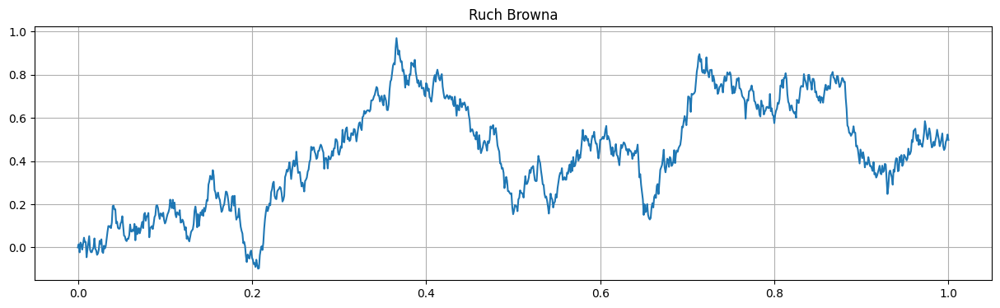

In [4]:
import numpy as np
import matplotlib.pyplot as plt

# Dla powtarzalności symulacji - można zakomentować
np.random.seed(1234)

def brownian_motion(N):
    """
    Simulates a Brownian motion
    
    :param int N: liczba kroków
    """
    random_increments = np.random.normal(0.0, 1.0, N) # przyrosty epsilon
    brownian_motion = np.cumsum(random_increments) / np.sqrt(N) # przybliżamy proces Wienera (ruchy Browna)
    brownian_motion = np.insert(brownian_motion, 0, 0.0) # dodajemy jeszcze wartość początkową

    return brownian_motion, random_increments

N = 1000 # Ustawimy dość duże N

# Generujemy ruch Browna
X, epsilon = brownian_motion(N)

plt.figure(figsize=(15,4))
plt.plot([i/N for i in range(N+1)], X)
plt.grid()
plt.title('Ruch Browna')
plt.show()

Za pomocą naszej funkcji zilustrujemy twierdzenie Donsker'a. W tym celu będziemy zwiększać $N$ i generować realizacje coraz dłuższych błądzeń losowych na odcinku [0,1]. Z uzyskanych relizacji stworzymy animowany wykres.

In [2]:
import matplotlib.pyplot as plt
# W celach stworzenia animacji
from matplotlib.animation import FuncAnimation

# Ustawienie, żeby animacja wyświetliła się w Jupyter notebook
plt.rcParams["animation.html"] = "jshtml"

fig = plt.figure(figsize=(21, 10))
ax = plt.axes(xlim=(0, 1))
line, = ax.step([], [], where='mid', color='#0492C2')

# Tworzenie stałych elementów wykresu
ax.set_xticks(np.linspace(0,1,11))
ax.set_xlabel('Time', fontsize=30)
ax.set_ylabel('Value', fontsize=30)
ax.tick_params(labelsize=22)
ax.grid(True, which='major', linestyle='--', color='black', alpha=0.6)

# Funkcja generująca klatki animacji
def animate(i):
    np.random.seed(42)
    y, epsilon = brownian_motion((i + 1) * 10)
    tr = np.linspace(0.0, 1, (i + 1) * 10 + 1)
    ax.set_title('Brownian Motion for {} steps'.format((i + 1) * 10), fontsize=40)
    ax.set_ylim((np.min(y) - 0.1, np.max(y) + 0.1))

    line.set_data(list(tr), list(y))
    return (line,)

# Utworzenie objektu klasy FuncAnimator
anim = FuncAnimation(fig=fig, func=animate, frames=100, interval=100, blit=True)
plt.close() # Żeby dodatkowo nie wyświetlała się ostatnia ramka jako oddzielny wykres 
anim

Naszą animację możemy też zapisać do pliku:

In [3]:
anim.save('brownian_motion.gif',writer='pillow')

Więcej o animacjach w Matplotlib można poczytać [tutaj](https://matplotlib.org/stable/users/explain/animations/animations.html).

---

**Zadanie domowe 10**

Zrobić animację w formacie GIF pokazującą działanie Centralnego Twierdzenia Granicznego dla niezależnych zmiennych losowych pochodzących z rozkładu wykładniczego bądź wybranego przez siebie innego rozkładu prawdopodobieństwa. Pomocny może być następujący przykład: [https://matplotlib.org/stable/gallery/animation/animated_histogram.html](https://matplotlib.org/stable/gallery/animation/animated_histogram.html). Rozwiązaniem powinien być kod w Pythonie tworzący plik GIF.

---

To teraz utworzymy klasę, która pozwoli nam generować proces Wienera (ruch Browna) za pomocą różnych rozkładów.

In [10]:
class Brownian():
    """
    A Brownian motion class constructor
    """
    def __init__(self,x0=0):
        """
        Init class
        """
        assert (type(x0)==float or type(x0)==int or x0 is None), "Expect a float or None for the initial value"
        
        self.x0 = float(x0)


    # Przybliżanie procesu Wienera za pomocą prostego błądzenia losowego
    def gen_random_walk(self,n_step=100):
        """
        Generate motion by random walk
        
        Arguments:
            n_step: Number of steps
            
        Returns:
            A NumPy array with `n_steps` points
        """
        # Warning about the small number of steps
        if n_step < 30:
            print("WARNING! The number of steps is small. It may not generate a good stochastic process sequence!")
        
        w = np.ones(n_step)*self.x0
        
        for i in range(1,n_step):
            yi = np.random.choice([1,-1])
            w[i] = w[i-1]+(yi/np.sqrt(n_step))
        
        return w

    
    # Przybliżanie procesu Wienera za pomocą procesu o przyrostach losowanych ze standardowego rozkładu normalnego
    def gen_normal(self,n_step=100):
        """
        Generate motion by drawing from the Normal distribution
        
        Arguments:
            n_step: Number of steps
            
        Returns:
            A NumPy array with `n_steps` points
        """
        if n_step < 30:
            print("WARNING! The number of steps is small. It may not generate a good stochastic process sequence!")
        
        w = np.ones(n_step)*self.x0
        
        for i in range(1,n_step):
            yi = np.random.normal()
            w[i] = w[i-1]+(yi/np.sqrt(n_step))
        
        return w

Wygenerujemy kilka trajektorii procesu Wienera za pomocą błądzenia losowego

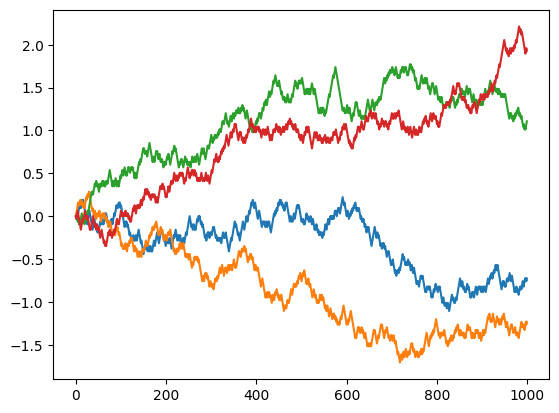

In [11]:
b = Brownian()

for i in range(4):
    plt.plot(b.gen_random_walk(1000))
plt.show()

Wygenerujemy kilka trajektorii procesu Wienera używając standardowego rozkładu normalnego

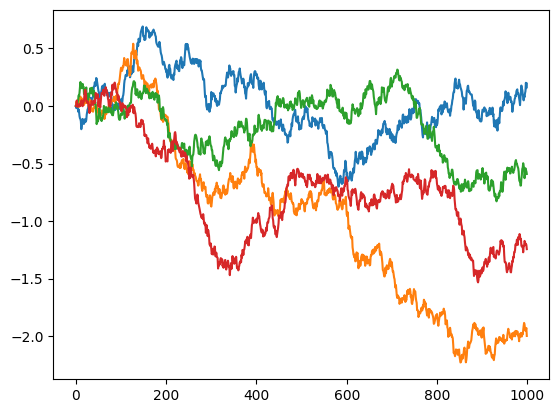

In [12]:
b = Brownian()

for i in range(4):
    plt.plot(b.gen_normal(1000))
plt.show()

Teraz zasymulujemy 2-wymiarowy ruch Browna imitujący zachowanie cząstki umieszczonej w cienkiej warstwie cieczy. Dodatkowo ładnie pokolorujemy trajektorię, co pozwoli nam lepiej zorientować się jak przemieszczała się cząstka.

Jeżeli użyjemy małej liczby kroków, to punkty nie będą blisko siebie i trajektoria nie będzie dobrze wyglądać. Dlatego skorzystamy z interpolacji i "dorzucimy" 10 pośrednich punków pomiędzy każde dwa wylosowane punkty.

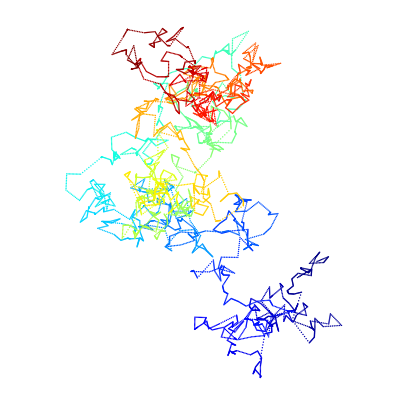

In [13]:
n = 1000

b1 = Brownian()
b2 = Brownian()

x = b1.gen_normal(n)
y = b2.gen_normal(n)

# Dodajemy 10 pośrednich punktów pomiędzy dwa
# kolejne ponkty. Interpolujemy x i y.
k = 10
x2 = np.interp(np.arange(n * k), np.arange(n) * k, x)
y2 = np.interp(np.arange(n * k), np.arange(n) * k, y)

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
# Rysujemy punkty używając gradientu koloru
ax.scatter(x2, y2, c=range(n * k), linewidths=0,
           marker='o', s=1, cmap=plt.cm.jet,)
ax.axis('equal')
ax.set_axis_off()


Lepszy rezultat uzyskamy zwiększając liczbę kroków. Ale jeżeli liczba ta jest odpowiednio duża, to intepolację możemy pominąć.

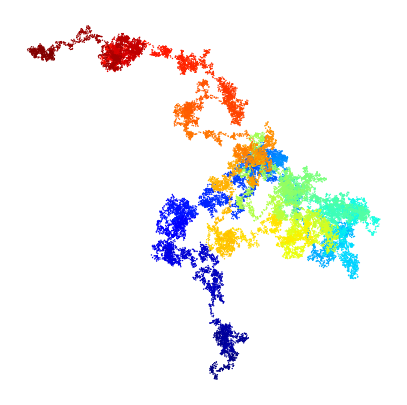

In [14]:
n = 30000

b1 = Brownian()
b2 = Brownian()

x = b1.gen_normal(n)
y = b2.gen_normal(n)

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.scatter(x, y, c=range(n), linewidths=0,
           marker='o', s=1, cmap=plt.cm.jet,)
ax.axis('equal')
ax.set_axis_off()

Skoro tak dobrze nam idzie, to czemu nie spróbować w 3D. Zasymulujemy ruch Browna imitujący zachowanie cząstki zawieszonej w cieczy wypełniającej naczynie.

Wykres 3D zrobimy z wykorzystaniem biblioteki plotly, dzięki czemu będzie interaktywny: będziemy mogli go obracać, przybliżać i oddalać.

In [15]:
import random
import numpy as np
import plotly.express as px

def simulate_3d_bm(nsteps=100000, t=1):
    x = np.cumsum([ np.random.randn()*np.sqrt(t) for i in range(nsteps) ])
    y = np.cumsum([ np.random.randn()*np.sqrt(t) for i in range(nsteps) ])
    z = np.cumsum([ np.random.randn()*np.sqrt(t) for i in range(nsteps) ])
    return list(x), list(y), list(z)

x, y, z = simulate_3d_bm()
fig = px.line_3d({ 'x' : x, 'y' : y, 'z' : z }, x='x', y='y', z='z')
fig.show()

---

Do czego jeszcze możemy użyć procesu Wienera?

Proces ten można wykorzystać do modelowania cen akcji na giełdzie. W tym celu wykorzystuje się tzw. Geometryczny Ruch Browna (sam w sobie nie jest ruchem Browna, ale staje się nim po zlogarytmowaniu, tj. $\ln{S(t)}$ jest ruchem Browna):

$$S(t) = S(0)e^{(\mu-\frac{\sigma^2}{2})t+\sigma\,W(t)}.$$

Zaimplementujemy nasz symulator rozszerzając pierwotną definicję klasy Brownian o metodę stock_price().

In [16]:
class Brownian():
    """
    A Brownian motion class constructor
    """
    def __init__(self,x0=0):
        """
        Init class
        """
        assert (type(x0)==float or type(x0)==int or x0 is None), "Expect a float or None for the initial value"
        
        self.x0 = float(x0)

    
    # Przybliżanie procesu Wienera za pomocą prostego błądzenia losowego
    def gen_random_walk(self,n_step=100):
        """
        Generate motion by random walk
        
        Arguments:
            n_step: Number of steps
            
        Returns:
            A NumPy array with `n_steps` points
        """
        # Warning about the small number of steps
        if n_step < 30:
            print("WARNING! The number of steps is small. It may not generate a good stochastic process sequence!")
        
        w = np.ones(n_step)*self.x0
        
        for i in range(1,n_step):
            yi = np.random.choice([1,-1])
            w[i] = w[i-1]+(yi/np.sqrt(n_step))
        
        return w

    
    # Przybliżanie procesu Wienera za pomocą procesu o przyrostach losowanych ze standardowego rozkładu normalnego
    def gen_normal(self,n_step=100):
        """
        Generate motion by drawing from the Normal distribution
        
        Arguments:
            n_step: Number of steps
            
        Returns:
            A NumPy array with `n_steps` points
        """
        if n_step < 30:
            print("WARNING! The number of steps is small. It may not generate a good stochastic process sequence!")
        
        w = np.ones(n_step)*self.x0
        
        for i in range(1,n_step):
            yi = np.random.normal()
            w[i] = w[i-1]+(yi/np.sqrt(n_step))
        
        return w

    
    def stock_price(
                    self,
                    s0=100,
                    mu=0.2,
                    sigma=0.68,
                    deltaT=52,
                    dt=0.1
                    ):
        """
        Models a stock price S(t) using the Wiener process W(t) as
        `S(t) = S(0).exp{(mu-(sigma^2/2).t)+sigma.W(t)}`
        
        Arguments:
            s0: Iniital stock price, default 100
            mu: 'Drift' of the stock (upwards or downwards), default 1
            sigma: 'Volatility' of the stock, default 1
            deltaT: The time period for which the future prices are computed, default 52 (as in 52 weeks)
            dt (optional): The granularity of the time-period, default 0.1
        
        Returns:
            s: A NumPy array with the simulated stock prices over the time-period deltaT
        """
        n_step = int(deltaT/dt)
        time_vector = np.linspace(0,deltaT,num=n_step)
        # Stock variation
        stock_var = (mu-(sigma**2/2))*time_vector
        # Forcefully set the initial value to zero for the stock price simulation
        self.x0=0
        # Wiener process (calls the `gen_normal` method)
        wiener_process = sigma*self.gen_normal(n_step)
        # Add two time series, take exponent, and multiply by the initial stock price
        s = s0*(np.exp(stock_var+wiener_process))
        
        return s

Zdefiniujemy następnie funkcję, która będzie wykreślała symulowane ceny akcji:

In [17]:
def plot_stock_price(mu,sigma):
    """
    Plots stock price for multiple scenarios
    """
    b = Brownian()
    
    plt.figure(figsize=(9,4))
    for i in range(5):
        plt.plot(b.stock_price(mu=mu,
                               sigma=sigma,
                               dt=0.1))
    plt.legend(['Akcje Firmy-'+str(i) for i in range(1,6)],
               loc='upper left')
    plt.hlines(y=100,xmin=0,xmax=520,
               linestyle='--',color='k')
    plt.show()

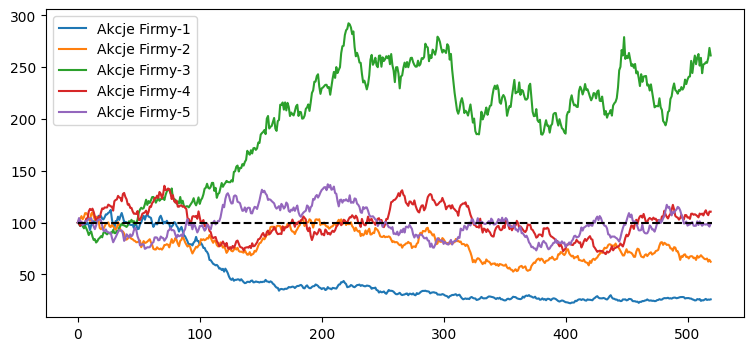

In [18]:
plot_stock_price(mu=0.2,sigma=0.65)

**Uwaga:** Model jest bardzo wrażliwy na wartość parametru sigma. Parametr ten pozwala na "sterowanie giełdą" ;). Oto dwa przykłady:

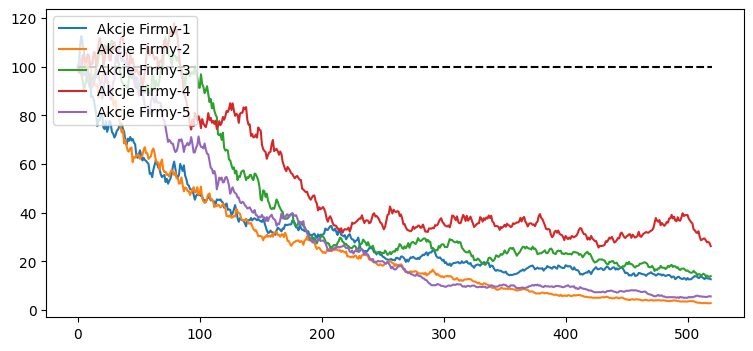

In [19]:
plot_stock_price(mu=0.2,sigma=0.7)

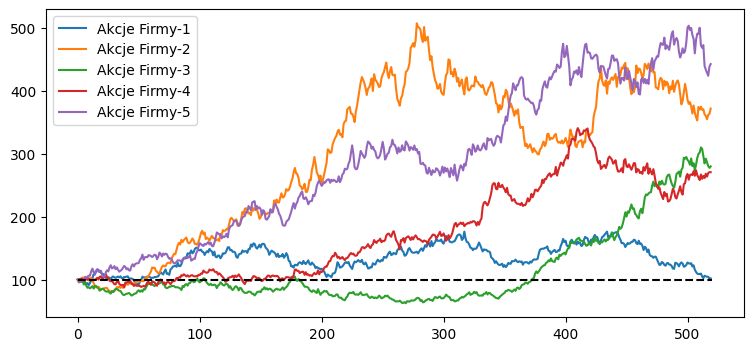

In [20]:
plot_stock_price(mu=0.2,sigma=0.6)